In [54]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, TimeSeriesSplit
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.feature_selection import chi2, RFE
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor,plot_tree
from sklearn.metrics import classification_report, roc_curve, roc_auc_score, silhouette_score, confusion_matrix
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
from scipy.stats import ttest_ind
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder,normalize, scale, StandardScaler
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from xgboost import XGBClassifier,XGBRegressor,plot_importance
import json
import itertools
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.stattools import adfuller
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
%matplotlib inline

In [2]:
features =  pd.read_parquet('features.parquet')
target =  pd.read_parquet('target.parquet')
features.shape
features.head()
target.shape
target.head()

(10000, 1000)

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
1990-01-01,0.943503,2.285943,-0.676534,-1.073370,0.222805,0.549741,-0.593814,2.178840,0.352440,0.201713,...,0.096125,0.953935,0.301930,-0.362019,-1.161094,0.653639,1.052906,0.412227,-0.554256,1.024348
1990-01-02,0.757759,0.420328,-0.171919,-0.256779,-0.026867,0.469453,-2.414748,-1.230617,-1.632244,-1.584294,...,1.929657,-0.209801,-0.152551,-0.696473,1.722749,0.661907,-1.248569,1.736036,0.291525,-0.461472
1990-01-03,1.321828,0.338798,-0.056767,0.831892,-0.237888,-0.280212,-0.863612,-0.339115,-0.197328,0.885977,...,-0.920220,-0.984264,0.561081,2.038433,0.073335,-0.187716,-0.597649,-0.091542,1.148625,0.413747
1990-01-04,0.791808,-1.413861,0.796525,-1.579936,1.093092,0.177056,-0.221590,0.454206,-0.883866,0.225825,...,-1.637996,-0.037544,0.299472,-1.459668,-1.006607,-1.116544,0.165441,0.946803,-0.738654,-0.376507
1990-01-05,0.703500,-1.096535,0.303689,0.841819,-1.199948,-0.336136,1.417628,0.440125,-1.757652,2.210187,...,-1.900305,-0.473095,-0.084830,-0.108897,-0.971338,-1.226582,1.515971,0.778013,1.755896,2.025973


(10000, 1)

,target
1990-01-01,0.187237
1990-01-02,0.583561
1990-01-03,0.584215
1990-01-04,-0.014664
1990-01-05,-0.896113


<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

C:\Users\sarahwang\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

<Figure size 504x504 with 0 Axes>

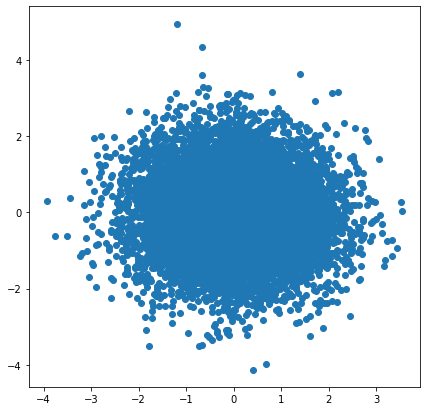

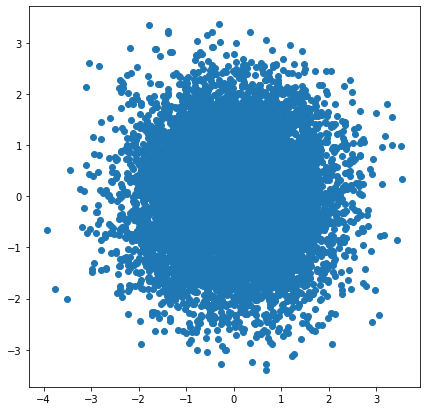

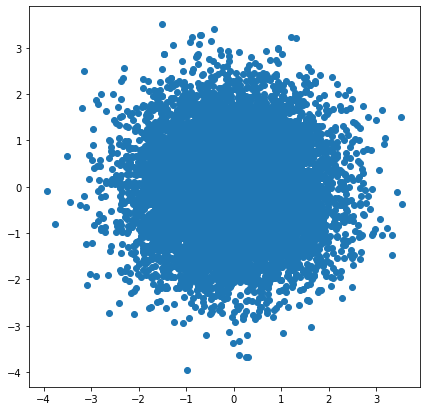

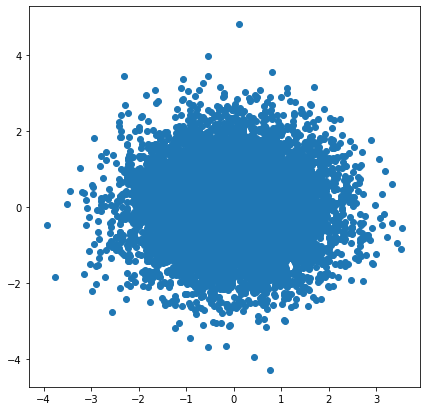

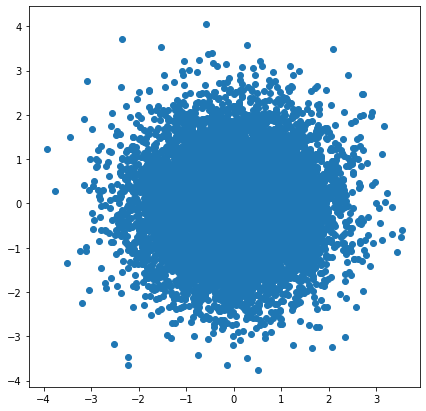

...

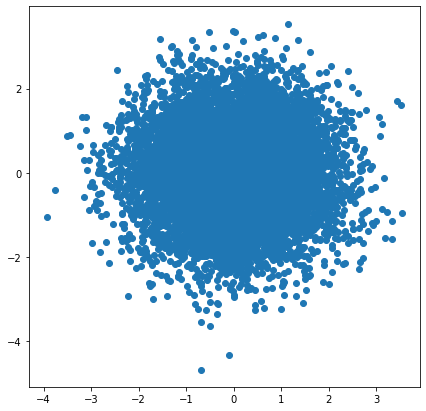

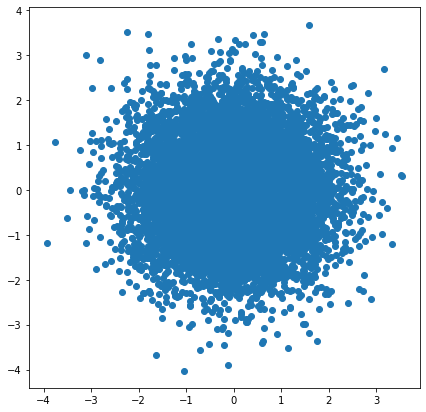

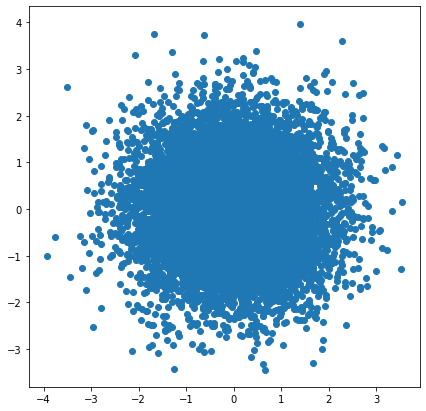

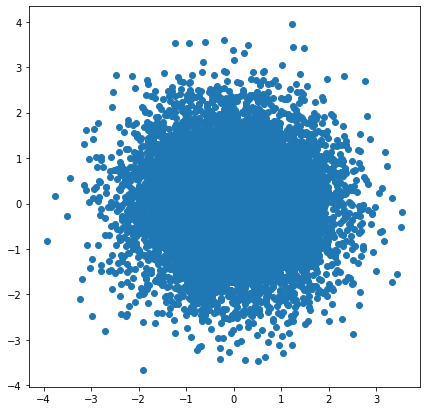

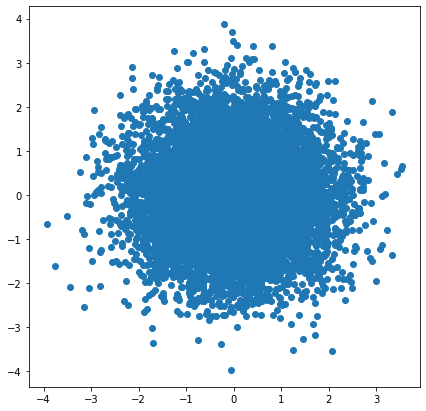

In [53]:
# I first created scatter plot for each feature, with target value, to see if there is any obvious relationship.
# All scatter plot shaped like a circle around the center value
for col in features.columns:
    plt.figure(figsize=(7, 7))
    plt.scatter(target, features[col])

In [3]:
# split test and training samples
train_size = 0.7
train_len = int(len(features.index) * train_size)
test_len = int(len(features.index) * (1-train_size))
xtrain = features.iloc[:train_len]
xtest = features.iloc[train_len:]
ytrain = target.iloc[:train_len]
ytest = target.iloc[train_len:]
xtrain.shape
xtrain.head()
xtrain.tail()
xtest.shape
xtest.head()
ytrain.shape
ytest.shape

(7000, 1000)

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
1990-01-01,0.943503,2.285943,-0.676534,-1.073370,0.222805,0.549741,-0.593814,2.178840,0.352440,0.201713,...,0.096125,0.953935,0.301930,-0.362019,-1.161094,0.653639,1.052906,0.412227,-0.554256,1.024348
1990-01-02,0.757759,0.420328,-0.171919,-0.256779,-0.026867,0.469453,-2.414748,-1.230617,-1.632244,-1.584294,...,1.929657,-0.209801,-0.152551,-0.696473,1.722749,0.661907,-1.248569,1.736036,0.291525,-0.461472
1990-01-03,1.321828,0.338798,-0.056767,0.831892,-0.237888,-0.280212,-0.863612,-0.339115,-0.197328,0.885977,...,-0.920220,-0.984264,0.561081,2.038433,0.073335,-0.187716,-0.597649,-0.091542,1.148625,0.413747
1990-01-04,0.791808,-1.413861,0.796525,-1.579936,1.093092,0.177056,-0.221590,0.454206,-0.883866,0.225825,...,-1.637996,-0.037544,0.299472,-1.459668,-1.006607,-1.116544,0.165441,0.946803,-0.738654,-0.376507
1990-01-05,0.703500,-1.096535,0.303689,0.841819,-1.199948,-0.336136,1.417628,0.440125,-1.757652,2.210187,...,-1.900305,-0.473095,-0.084830,-0.108897,-0.971338,-1.226582,1.515971,0.778013,1.755896,2.025973


,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2009-02-25,0.080533,0.256312,0.559213,1.508573,-0.952171,-0.063566,-2.106840,1.232395,1.730807,-1.178106,...,0.020103,1.339799,0.368437,-1.492337,1.643798,1.277063,0.327296,0.701744,0.542135,-1.219524
2009-02-26,-0.540102,-1.303380,-0.708246,-0.882363,0.587085,0.489231,-0.034246,-1.309256,-1.398321,0.729492,...,0.039901,-0.068265,0.573422,-0.426901,-2.334531,0.265245,0.620735,-1.373623,0.601200,0.966787
2009-02-27,0.361646,-2.647456,0.687982,2.068186,1.602446,0.698092,0.875561,-1.077449,-0.402130,0.377512,...,-0.008212,1.080585,-0.493124,-0.357810,0.675277,-2.370957,-0.081190,2.212157,-0.707208,-0.943612
2009-02-28,2.320730,-1.205485,0.891637,0.290391,-1.215879,1.059935,-0.714370,0.033922,-0.347714,0.185106,...,0.876502,1.333054,0.118427,-0.167022,-0.740728,-0.122609,1.360370,-1.604320,0.187666,0.184501
2009-03-01,-0.489193,1.548652,-2.301989,-0.230718,-1.228268,-0.208020,1.476721,-1.531453,-0.298059,-0.735896,...,-0.934719,2.551681,0.045813,0.646710,-0.853424,0.314131,-2.215948,0.488905,-0.555551,-1.060801


(3000, 1000)

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2009-03-02,0.959959,-0.135630,-0.719417,0.633197,0.162678,0.954001,0.218915,-1.077025,0.337764,2.078492,...,-0.226721,-0.671868,1.767070,-0.334827,-0.043890,-0.037443,-0.318301,1.047346,-0.008123,-0.391694
2009-03-03,0.151288,0.577267,0.582642,0.868066,0.967827,-0.705060,-1.429996,-0.365355,1.430644,-1.010319,...,-0.514840,-0.477410,-0.585001,1.156334,1.500593,0.622640,1.537334,-0.996524,0.136070,-1.243357
2009-03-04,-0.762183,0.558467,1.570452,-0.161511,0.755039,0.066518,-0.123605,-0.244742,0.257167,0.235104,...,-0.238711,0.095388,0.171662,-0.638782,-1.391247,0.012936,-0.526739,-0.115704,2.124018,-0.842850
2009-03-05,0.142225,0.432812,0.334751,1.324464,1.227664,-0.825051,-0.250942,0.842679,0.600740,0.144661,...,0.035249,-0.137280,-1.828886,-0.345241,-1.724927,-0.103295,0.111466,-0.023077,-1.791797,-0.386819
2009-03-06,-0.320024,0.170332,-0.892417,0.113862,0.292723,-1.074066,-0.347674,1.159304,-1.054585,-1.011236,...,0.781884,-0.029404,-0.028342,-0.613715,0.788471,-0.821906,0.271830,-1.952343,0.718141,0.755541


(7000, 1)

(3000, 1)

To select the top features, I used Recursive Feature Elimination approach. It removes features one at a time based on the weights given by the decision tree model. Since RFE trains the given model on the training dataset every time it drops a feature, the computation time will be heavy for large datasets with many features as ours. To control this behavior, for initial feature selection, I reduced features from 1000 features to 100 features with step size of 50. And for second iternation, I reduced the number of features from 100 to 10 with step size of 5. And for the last iteration, I reduced the number of features from 10 to 3 with step size of 1. Because when dropping features, other features' coefficients will change too. With smaller step size, the accuracy can be improved with each iteration. The final selected features are 63, 68, and 116.

To understand the leading indicator power of the three selected features. I ran Granger Causality test. It is an econometric hypothetical test for verifying the usage of one variable in forecasting another in multivariate time series data with a particular lag. A prerequisite for performing the Granger Causality test is that the data need to be stationary. Therefore, I first applied Augmented Dickey-Fuller Test to test whether selected features and target values are stationary. With pvalue less than 0.05, selected features and target values are stationary. With that, for each selected fature, I ran Granger Causality test with the target value, using lag from 1 to 40. With 90% confidence, feature 68 is statistically significant at lag 5, and feature 116 is statistically significant at lag 10. 

I used the three selected features and feed into the decision tree model, it gives us MAE of 1.13. After hyperparameter tuning, the MAE can reach 0.79, which is the same (best) MAE trained wtih 200 features from the first notebook. This indicates after significantly reducing the number of features, the predictive power is not reduced. 

In [4]:
# first iteration of RFE: reduced features from 1000 features to 100 features with step size of 50
rfe = RFE(DecisionTreeRegressor(), n_features_to_select=100,verbose = 1, step = 50)
fit = rfe.fit(xtrain, ytrain)

Fitting estimator with 1000 features.
Fitting estimator with 950 features.
Fitting estimator with 900 features.
Fitting estimator with 850 features.
Fitting estimator with 800 features.
Fitting estimator with 750 features.
Fitting estimator with 700 features.
Fitting estimator with 650 features.
Fitting estimator with 600 features.
Fitting estimator with 550 features.
Fitting estimator with 500 features.
Fitting estimator with 450 features.
Fitting estimator with 400 features.
Fitting estimator with 350 features.
Fitting estimator with 300 features.
Fitting estimator with 250 features.
Fitting estimator with 200 features.
Fitting estimator with 150 features.


In [6]:
selected_features = features.loc[:, rfe.support_]
selected_features

,8,12,16,25,28,29,43,50,51,60,...,896,922,927,928,937,940,953,955,995,998
1990-01-01,0.352440,-0.651325,1.088218,1.510890,-0.399373,0.587409,-0.349929,0.035688,1.240499,-0.014375,...,0.389934,-0.011325,0.648915,-0.389401,0.978681,-0.322961,-1.165791,0.985955,0.653639,-0.554256
1990-01-02,-1.632244,-0.636205,0.239160,0.373260,0.297199,1.073088,0.733281,1.347703,-0.450906,0.659181,...,-0.331425,0.190445,-0.348157,-0.984072,0.170166,1.388391,-0.227392,-0.777529,0.661907,0.291525
1990-01-03,-0.197328,0.379628,0.568235,1.391711,-1.382852,-0.051441,-0.416283,0.514938,0.798978,0.577239,...,-1.235779,0.495367,-0.188043,-0.308618,-0.319797,0.394648,0.284877,-0.078610,-0.187716,1.148625
1990-01-04,-0.883866,-1.720958,0.458932,-1.565731,1.965803,-0.296780,0.235380,-0.087729,0.663723,-1.053238,...,-0.353783,-0.196662,-0.707359,1.229269,0.591552,0.782938,-0.986230,2.774443,-1.116544,-0.738654
1990-01-05,-1.757652,0.085739,0.515390,0.326067,0.587934,0.524584,1.373958,0.294015,1.735400,2.848771,...,0.311864,-0.001105,0.874411,-0.873334,0.449451,-0.151034,0.251320,-1.261528,-1.226582,1.755896
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-05-14,-1.240647,0.133710,-0.331580,-2.803098,-0.599838,1.516268,-0.956377,1.696360,0.681463,1.038322,...,-0.160204,-1.395405,0.843057,-0.270957,-1.564934,1.718470,1.114902,0.126605,0.840357,-1.615012
2017-05-15,1.224130,0.315819,-0.642298,-1.325134,-1.135335,0.544140,-2.043236,1.124157,-0.408465,-0.887274,...,0.665245,0.908817,1.143850,0.891193,1.599430,0.260088,-1.476568,2.758222,0.328590,0.602707
2017-05-16,0.077246,-1.133253,0.100095,0.045422,0.430700,-0.382740,0.665514,1.418406,1.036822,-0.737684,...,1.029693,0.804689,-0.493373,0.906568,-0.102622,-1.545940,-0.326514,-2.452374,-0.037348,0.256116
2017-05-17,2.543769,-1.066824,0.762978,-0.052113,0.293978,0.371114,-1.032803,-0.336689,2.197116,0.987169,...,0.116984,-1.601390,0.883924,0.771376,-0.075371,0.137944,-0.653623,1.810065,0.222112,-0.973560


In [8]:
# second iteration of RFE: reduced features from 100 features to 10 features with step size of 5
rfe = RFE(DecisionTreeRegressor(), n_features_to_select=10,verbose = 1, step = 5)
fit = rfe.fit(selected_features.iloc[:train_len], ytrain)

Fitting estimator with 100 features.
Fitting estimator with 95 features.
Fitting estimator with 90 features.
Fitting estimator with 85 features.
Fitting estimator with 80 features.
Fitting estimator with 75 features.
Fitting estimator with 70 features.
Fitting estimator with 65 features.
Fitting estimator with 60 features.
Fitting estimator with 55 features.
Fitting estimator with 50 features.
Fitting estimator with 45 features.
Fitting estimator with 40 features.
Fitting estimator with 35 features.
Fitting estimator with 30 features.
Fitting estimator with 25 features.
Fitting estimator with 20 features.
Fitting estimator with 15 features.


In [9]:
selected_features2 = selected_features.loc[:, rfe.support_]
selected_features2

,63,68,103,116,167,280,896,928,937,955
1990-01-01,0.539722,1.899967,1.048738,-1.578935,0.869894,0.609481,0.389934,-0.389401,0.978681,0.985955
1990-01-02,-0.039807,-0.079867,0.378014,-1.291941,0.774293,0.174498,-0.331425,-0.984072,0.170166,-0.777529
1990-01-03,-0.152437,-0.101332,0.592794,-0.481747,-1.039220,-0.731115,-1.235779,-0.308618,-0.319797,-0.078610
1990-01-04,1.110265,-0.428560,0.705490,1.370206,-1.102491,0.628682,-0.353783,1.229269,0.591552,2.774443
1990-01-05,-0.144050,0.392743,-0.906980,-0.639227,-0.092884,0.185919,0.311864,-0.873334,0.449451,-1.261528
...,...,...,...,...,...,...,...,...,...,...
2017-05-14,-0.275535,-0.762803,0.301746,-0.956851,-1.720398,0.175981,-0.160204,-0.270957,-1.564934,0.126605
2017-05-15,0.426908,-0.716327,-0.011176,-0.188390,-0.597361,-0.423944,0.665245,0.891193,1.599430,2.758222
2017-05-16,0.152238,-0.440477,-1.195398,-0.029863,1.012624,-0.308874,1.029693,0.906568,-0.102622,-2.452374
2017-05-17,-1.316250,-0.315804,-1.101772,-1.016385,-0.587264,0.230860,0.116984,0.771376,-0.075371,1.810065


In [10]:
# third iteration of RFE: reduced features from 10 features to 3 features with step size of 1
rfe = RFE(DecisionTreeRegressor(), n_features_to_select=3,verbose = 1, step = 1)
fit = rfe.fit(selected_features2.iloc[:train_len], ytrain)

Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 features.
Fitting estimator with 4 features.


In [11]:
selected_features_final = selected_features2.loc[:, rfe.support_]
selected_features_final

,63,68,116
1990-01-01,0.539722,1.899967,-1.578935
1990-01-02,-0.039807,-0.079867,-1.291941
1990-01-03,-0.152437,-0.101332,-0.481747
1990-01-04,1.110265,-0.428560,1.370206
1990-01-05,-0.144050,0.392743,-0.639227
...,...,...,...
2017-05-14,-0.275535,-0.762803,-0.956851
2017-05-15,0.426908,-0.716327,-0.188390
2017-05-16,0.152238,-0.440477,-0.029863
2017-05-17,-1.316250,-0.315804,-1.016385


In [13]:
# feed into decision tree model
dt_model = DecisionTreeRegressor()
dt_model.fit(selected_features_final.iloc[:train_len,:], ytrain)
dt_modell_pred = dt_model.predict(selected_features_final.iloc[train_len:,:])
print(f'MAE:  {mean_absolute_error(y_pred=dt_modell_pred, y_true = ytest)}')

DecisionTreeRegressor()

MAE:  1.1280894783480766


In [14]:
# hyperparameter tuning
model = DecisionTreeRegressor()
param_search = { 
    'min_samples_leaf': [5, 10,20],
    'max_depth' : [2, 3, 5, 10, 20]
}
tscv = TimeSeriesSplit(n_splits=4)
gsearch = GridSearchCV(estimator=model, cv=tscv, param_grid=param_search, scoring = 'neg_mean_absolute_error', n_jobs = -1, verbose=1)
gsearch.fit(selected_features_final.iloc[:train_len,:], ytrain)
best_score = gsearch.best_score_
best_model = gsearch.best_estimator_

Fitting 4 folds for each of 15 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    4.3s finished


GridSearchCV(cv=TimeSeriesSplit(max_train_size=None, n_splits=4),
             estimator=DecisionTreeRegressor(), n_jobs=-1,
             param_grid={'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20]},
             scoring='neg_mean_absolute_error', verbose=1)

In [15]:
# MAE result from the best model
best_model_pred = best_model.predict(selected_features_final.iloc[train_len:,:])
print(f'MAE:  {mean_absolute_error(y_pred=best_model_pred, y_true = ytest)}')

MAE:  0.7911652495825465


In [40]:
selected_features_train = selected_features_final.iloc[:7000]
selected_features_train

,63,68,116
1990-01-01,0.539722,1.899967,-1.578935
1990-01-02,-0.039807,-0.079867,-1.291941
1990-01-03,-0.152437,-0.101332,-0.481747
1990-01-04,1.110265,-0.428560,1.370206
1990-01-05,-0.144050,0.392743,-0.639227
...,...,...,...
2009-02-25,-0.333758,-0.796636,-1.399109
2009-02-26,-0.555711,0.397846,-1.699653
2009-02-27,0.084811,0.928027,-0.887263
2009-02-28,-0.276820,-1.511735,1.113190


In [39]:
# run adfuller test to check stationary -> stationary
result = adfuller(ytrain)
print(f'Test Statistics: {result[0]}')
print(f'p-value: {result[1]}')
print(f'critical_values: {result[4]}')

Test Statistics: -57.68589240712909
p-value: 0.0
critical_values: {'1%': -3.431284795699821, '5%': -2.86195310457954, '10%': -2.5669898915976566}


In [41]:
# run adfuller test to check stationary -> stationary
result = adfuller(selected_features_train['63'])
print(f'Test Statistics: {result[0]}')
print(f'p-value: {result[1]}')
print(f'critical_values: {result[4]}')

Test Statistics: -50.181010449924486
p-value: 0.0
critical_values: {'1%': -3.4312849293483816, '5%': -2.8619531636321742, '10%': -2.566989923032409}


In [42]:
# run adfuller test to check stationary -> stationary
result = adfuller(selected_features_train['68'])
print(f'Test Statistics: {result[0]}')
print(f'p-value: {result[1]}')
print(f'critical_values: {result[4]}')

Test Statistics: -83.70032077859523
p-value: 0.0
critical_values: {'1%': -3.431284662089465, '5%': -2.8619530455437836, '10%': -2.566989860171889}


In [43]:
# run adfuller test to check stationary
result = adfuller(selected_features_train['116'])
print(f'Test Statistics: {result[0]}')
print(f'p-value: {result[1]}')
print(f'critical_values: {result[4]}')

Test Statistics: -30.781560158696713
p-value: 0.0
critical_values: {'1%': -3.431285598164831, '5%': -2.861953459148772, '10%': -2.566990080341083}


In [48]:
# run granger causality test to check whether it is leading indicator of the target value -> statistically significant at lag 10
grangercausalitytests(pd.concat([ytrain, selected_features_train['116']], axis = 1), maxlag=40)


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.5510  , p=0.4579  , df_denom=6996, df_num=1
ssr based chi2 test:   chi2=0.5512  , p=0.4578  , df=1
likelihood ratio test: chi2=0.5512  , p=0.4578  , df=1
parameter F test:         F=0.5510  , p=0.4579  , df_denom=6996, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.7146  , p=0.4894  , df_denom=6993, df_num=2
ssr based chi2 test:   chi2=1.4303  , p=0.4891  , df=2
likelihood ratio test: chi2=1.4301  , p=0.4892  , df=2
parameter F test:         F=0.7146  , p=0.4894  , df_denom=6993, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.5910  , p=0.6209  , df_denom=6990, df_num=3
ssr based chi2 test:   chi2=1.7747  , p=0.6204  , df=3
likelihood ratio test: chi2=1.7745  , p=0.6205  , df=3
parameter F test:         F=0.5910  , p=0.6209  , df_denom=6990, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=1.1398  , p=0.

likelihood ratio test: chi2=32.3491 , p=0.2605  , df=28
parameter F test:         F=1.1485  , p=0.2687  , df_denom=6915, df_num=28

Granger Causality
number of lags (no zero) 29
ssr based F test:         F=1.1096  , p=0.3126  , df_denom=6912, df_num=29
ssr based chi2 test:   chi2=32.4524 , p=0.3004  , df=29
likelihood ratio test: chi2=32.3771 , p=0.3036  , df=29
parameter F test:         F=1.1096  , p=0.3126  , df_denom=6912, df_num=29

Granger Causality
number of lags (no zero) 30
ssr based F test:         F=1.1014  , p=0.3212  , df_denom=6909, df_num=30
ssr based chi2 test:   chi2=33.3352 , p=0.3082  , df=30
likelihood ratio test: chi2=33.2558 , p=0.3116  , df=30
parameter F test:         F=1.1014  , p=0.3212  , df_denom=6909, df_num=30

Granger Causality
number of lags (no zero) 31
ssr based F test:         F=1.0824  , p=0.3450  , df_denom=6906, df_num=31
ssr based chi2 test:   chi2=33.8607 , p=0.3311  , df=31
likelihood ratio test: chi2=33.7787 , p=0.3347  , df=31
parameter F test:

{1: ({'ssr_ftest': (0.550980572965708, 0.45794222919086836, 6996.0, 1),
   'ssr_chi2test': (0.5512168425081462, 0.4578209188133976, 1),
   'lrtest': (0.5511951376865909, 0.45782977234335864, 1),
   'params_ftest': (0.5509805729638607, 0.45794222919181926, 6996.0, 1.0)},
   array([[0., 1., 0.]])]),
 2: ({'ssr_ftest': (0.7146217090828502, 0.4894129383658522, 6993.0, 2),
   'ssr_chi2test': (1.430265328231599, 0.4891272178620075, 2),
   'lrtest': (1.4301191878876125, 0.48916295977776125, 2),
   'params_ftest': (0.7146217090820648, 0.48941293836623245, 6993.0, 2.0)},
   array([[0., 0., 1., 0., 0.],
          [0., 0., 0., 1., 0.]])]),
 3: ({'ssr_ftest': (0.5909913010156239, 0.6208551593370228, 6990.0, 3),
   'ssr_chi2test': (1.7747494133932706, 0.620445100853946, 3),
   'lrtest': (1.7745243738754652, 0.6204943463030186, 3),
   'params_ftest': (0.5909913010151563, 0.6208551593373625, 6990.0, 3.0)},
   array([[0., 0., 0., 1., 0., 0., 0.],
          [0., 0., 0., 0., 1., 0., 0.],
          [0., 

In [49]:
# run granger causality test to check whether it is leading indicator of the target value -> statistically significant at lag 5
grangercausalitytests(pd.concat([ytrain, selected_features_train['68']], axis = 1), maxlag=40)


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.8377  , p=0.3601  , df_denom=6996, df_num=1
ssr based chi2 test:   chi2=0.8380  , p=0.3600  , df=1
likelihood ratio test: chi2=0.8380  , p=0.3600  , df=1
parameter F test:         F=0.8377  , p=0.3601  , df_denom=6996, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.5083  , p=0.6015  , df_denom=6993, df_num=2
ssr based chi2 test:   chi2=1.0173  , p=0.6013  , df=2
likelihood ratio test: chi2=1.0172  , p=0.6013  , df=2
parameter F test:         F=0.5083  , p=0.6015  , df_denom=6993, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=2.3808  , p=0.0676  , df_denom=6990, df_num=3
ssr based chi2 test:   chi2=7.1496  , p=0.0673  , df=3
likelihood ratio test: chi2=7.1460  , p=0.0674  , df=3
parameter F test:         F=2.3808  , p=0.0676  , df_denom=6990, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=1.8222  , p=0.

ssr based F test:         F=0.9007  , p=0.6157  , df_denom=6915, df_num=28
ssr based chi2 test:   chi2=25.4286 , p=0.6044  , df=28
likelihood ratio test: chi2=25.3824 , p=0.6070  , df=28
parameter F test:         F=0.9007  , p=0.6157  , df_denom=6915, df_num=28

Granger Causality
number of lags (no zero) 29
ssr based F test:         F=0.8913  , p=0.6335  , df_denom=6912, df_num=29
ssr based chi2 test:   chi2=26.0692 , p=0.6218  , df=29
likelihood ratio test: chi2=26.0206 , p=0.6244  , df=29
parameter F test:         F=0.8913  , p=0.6335  , df_denom=6912, df_num=29

Granger Causality
number of lags (no zero) 30
ssr based F test:         F=0.8729  , p=0.6654  , df_denom=6909, df_num=30
ssr based chi2 test:   chi2=26.4175 , p=0.6537  , df=30
likelihood ratio test: chi2=26.3675 , p=0.6562  , df=30
parameter F test:         F=0.8729  , p=0.6654  , df_denom=6909, df_num=30

Granger Causality
number of lags (no zero) 31
ssr based F test:         F=0.8388  , p=0.7209  , df_denom=6906, df_num=3

{1: ({'ssr_ftest': (0.8376508989159731, 0.3601010242673628, 6996.0, 1),
   'ssr_chi2test': (0.8380100974146507, 0.3599665047718046, 1),
   'lrtest': (0.8379599327563483, 0.35998088360560887, 1),
   'params_ftest': (0.8376508989157502, 0.3601010242673628, 6996.0, 1.0)},
   array([[0., 1., 0.]])]),
 2: ({'ssr_ftest': (0.5082901290818987, 0.6015454488053928, 6993.0, 2),
   'ssr_chi2test': (1.01730711377524, 0.6013046565146901, 2),
   'lrtest': (1.0172331774010672, 0.601326886068619, 2),
   'params_ftest': (0.5082901290815378, 0.6015454488056264, 6993.0, 2.0)},
   array([[0., 0., 1., 0., 0.],
          [0., 0., 0., 1., 0.]])]),
 3: ({'ssr_ftest': (2.3808218355352686, 0.0675869973059135, 6990.0, 3),
   'ssr_chi2test': (7.149618190231877, 0.06727878097222244, 3),
   'lrtest': (7.145967893990019, 0.06738797544759786, 3),
   'params_ftest': (2.3808218355351336, 0.0675869973059135, 6990.0, 3.0)},
   array([[0., 0., 0., 1., 0., 0., 0.],
          [0., 0., 0., 0., 1., 0., 0.],
          [0., 0., 

In [52]:
# run granger causality test to check whether it is leading indicator of the target value 
grangercausalitytests(pd.concat([ytrain, selected_features_train['63']], axis = 1), maxlag=40)


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.8397  , p=0.3595  , df_denom=6996, df_num=1
ssr based chi2 test:   chi2=0.8401  , p=0.3594  , df=1
likelihood ratio test: chi2=0.8400  , p=0.3594  , df=1
parameter F test:         F=0.8397  , p=0.3595  , df_denom=6996, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.4213  , p=0.6562  , df_denom=6993, df_num=2
ssr based chi2 test:   chi2=0.8432  , p=0.6560  , df=2
likelihood ratio test: chi2=0.8431  , p=0.6560  , df=2
parameter F test:         F=0.4213  , p=0.6562  , df_denom=6993, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=1.2163  , p=0.3020  , df_denom=6990, df_num=3
ssr based chi2 test:   chi2=3.6527  , p=0.3015  , df=3
likelihood ratio test: chi2=3.6517  , p=0.3016  , df=3
parameter F test:         F=1.2163  , p=0.3020  , df_denom=6990, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=0.9454  , p=0.

likelihood ratio test: chi2=13.9298 , p=0.9877  , df=28
parameter F test:         F=0.4939  , p=0.9883  , df_denom=6915, df_num=28

Granger Causality
number of lags (no zero) 29
ssr based F test:         F=0.4947  , p=0.9894  , df_denom=6912, df_num=29
ssr based chi2 test:   chi2=14.4677 , p=0.9887  , df=29
likelihood ratio test: chi2=14.4527 , p=0.9888  , df=29
parameter F test:         F=0.4947  , p=0.9894  , df_denom=6912, df_num=29

Granger Causality
number of lags (no zero) 30
ssr based F test:         F=0.4835  , p=0.9922  , df_denom=6909, df_num=30
ssr based chi2 test:   chi2=14.6338 , p=0.9917  , df=30
likelihood ratio test: chi2=14.6185 , p=0.9917  , df=30
parameter F test:         F=0.4835  , p=0.9922  , df_denom=6909, df_num=30

Granger Causality
number of lags (no zero) 31
ssr based F test:         F=0.4779  , p=0.9937  , df_denom=6906, df_num=31
ssr based chi2 test:   chi2=14.9486 , p=0.9933  , df=31
likelihood ratio test: chi2=14.9326 , p=0.9933  , df=31
parameter F test:

{1: ({'ssr_ftest': (0.8397186061121609, 0.3595088477725876, 6996.0, 1),
   'ssr_chi2test': (0.8400786912777322, 0.359374266048229, 1),
   'lrtest': (0.8400282786642492, 0.3593886832346168, 1),
   'params_ftest': (0.8397186061115732, 0.3595088477725876, 6996.0, 1.0)},
   array([[0., 1., 0.]])]),
 2: ({'ssr_ftest': (0.42129771045239517, 0.6562113702791645, 6993.0, 2),
   'ssr_chi2test': (0.8431978772331935, 0.655997081738963, 2),
   'lrtest': (0.8431470823197742, 0.6560137426080193, 2),
   'params_ftest': (0.4212977104516767, 0.6562113702799287, 6993.0, 2.0)},
   array([[0., 0., 1., 0., 0.],
          [0., 0., 0., 1., 0.]])]),
 3: ({'ssr_ftest': (1.2163495944334135, 0.30202422176003746, 6990.0, 3),
   'ssr_chi2test': (3.652703052468066, 0.30149036616722663, 3),
   'lrtest': (3.6517499584297184, 0.30160738446152635, 3),
   'params_ftest': (1.2163495944333331, 0.30202422176003746, 6990.0, 3.0)},
   array([[0., 0., 0., 1., 0., 0., 0.],
          [0., 0., 0., 0., 1., 0., 0.],
          [0., 